In [31]:
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.metrics import accuracy_score, confusion_matrix
from sklearn.model_selection import GridSearchCV
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler, MinMaxScaler, LabelEncoder
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.decomposition import KernelPCA
from yellowbrick.cluster import KElbowVisualizer
import warnings
warnings.filterwarnings('ignore')

In [2]:
df=pd.read_csv('Group_9_data_cleaned.csv')
df

,Unnamed: 0,current_1,current_2,current_3,current_4,current_5,current_6,current_7,current_8,current_9,...,current_41,current_42,current_43,current_44,current_45,current_46,current_47,current_48,current_49,output
0,1,0.0,-3.014600e-07,8.260300e-06,-0.000012,-0.000002,-1.438600e-06,-0.000021,0.031718,0.031710,...,-0.63308,2.9646,8.1198,-1.4961,-1.4961,-1.4961,-1.4996,-1.49960,-1.49960,1
1,2,1.0,2.913200e-06,-5.247700e-06,0.000003,-0.000006,2.778900e-06,-0.000004,0.030804,0.030810,...,-0.59314,7.6252,6.1690,-1.4967,-1.4967,-1.4967,-1.5005,-1.50050,-1.50050,1
2,3,2.0,-2.951700e-06,-3.184000e-06,-0.000016,-0.000001,-1.575300e-06,0.000017,0.032877,0.032880,...,-0.63252,2.7784,5.3017,-1.4983,-1.4983,-1.4982,-1.4985,-1.49850,-1.49850,1
3,4,3.0,-1.322600e-06,8.820100e-06,-0.000016,-0.000005,-7.282900e-07,0.000004,0.029410,0.029401,...,-0.62289,6.5534,6.2606,-1.4963,-1.4963,-1.4963,-1.4975,-1.49750,-1.49760,1
4,5,4.0,-6.836600e-08,5.666300e-07,-0.000026,-0.000006,-7.940600e-07,0.000013,0.030119,0.030119,...,-0.63010,4.5155,9.5231,-1.4958,-1.4958,-1.4958,-1.4959,-1.49590,-1.49590,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58504,58505,58504.0,-9.982500e-06,1.854900e-06,-0.000021,0.000017,-5.910200e-06,-0.000098,-0.083417,-0.083419,...,-0.52907,1.4641,7.0032,-1.5024,-1.5025,-1.5023,-1.4933,-1.49330,-1.49330,11
58505,58506,58505.0,-1.055400e-05,1.983500e-05,0.000031,-0.000018,-6.547550e-05,0.000289,-0.085131,-0.085151,...,-0.51971,3.3275,2.3072,-1.5024,-1.5025,-1.5024,-1.4925,-1.49250,-1.49260,11
58506,58507,58506.0,-5.857700e-06,1.859400e-05,-0.000102,-0.000003,3.827500e-06,0.000117,-0.081989,-0.082008,...,-0.51103,18.5458,9.0437,-1.5035,-1.5035,-1.5039,-1.4911,-1.49135,-1.49125,11
58507,58508,58507.0,-4.441100e-06,3.396900e-05,-0.000294,0.000005,6.500800e-06,0.000087,-0.081500,-0.081534,...,-0.52033,1.3890,10.7430,-1.5029,-1.5029,-1.5030,-1.4932,-1.49320,-1.49310,11


In [3]:
df = df.iloc[:,1:]
df

,current_1,current_2,current_3,current_4,current_5,current_6,current_7,current_8,current_9,current_10,...,current_41,current_42,current_43,current_44,current_45,current_46,current_47,current_48,current_49,output
0,0.0,-3.014600e-07,8.260300e-06,-0.000012,-0.000002,-1.438600e-06,-0.000021,0.031718,0.031710,0.031721,...,-0.63308,2.9646,8.1198,-1.4961,-1.4961,-1.4961,-1.4996,-1.49960,-1.49960,1
1,1.0,2.913200e-06,-5.247700e-06,0.000003,-0.000006,2.778900e-06,-0.000004,0.030804,0.030810,0.030806,...,-0.59314,7.6252,6.1690,-1.4967,-1.4967,-1.4967,-1.5005,-1.50050,-1.50050,1
2,2.0,-2.951700e-06,-3.184000e-06,-0.000016,-0.000001,-1.575300e-06,0.000017,0.032877,0.032880,0.032896,...,-0.63252,2.7784,5.3017,-1.4983,-1.4983,-1.4982,-1.4985,-1.49850,-1.49850,1
3,3.0,-1.322600e-06,8.820100e-06,-0.000016,-0.000005,-7.282900e-07,0.000004,0.029410,0.029401,0.029417,...,-0.62289,6.5534,6.2606,-1.4963,-1.4963,-1.4963,-1.4975,-1.49750,-1.49760,1
4,4.0,-6.836600e-08,5.666300e-07,-0.000026,-0.000006,-7.940600e-07,0.000013,0.030119,0.030119,0.030145,...,-0.63010,4.5155,9.5231,-1.4958,-1.4958,-1.4958,-1.4959,-1.49590,-1.49590,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58504,58504.0,-9.982500e-06,1.854900e-06,-0.000021,0.000017,-5.910200e-06,-0.000098,-0.083417,-0.083419,-0.083398,...,-0.52907,1.4641,7.0032,-1.5024,-1.5025,-1.5023,-1.4933,-1.49330,-1.49330,11
58505,58505.0,-1.055400e-05,1.983500e-05,0.000031,-0.000018,-6.547550e-05,0.000289,-0.085131,-0.085151,-0.085182,...,-0.51971,3.3275,2.3072,-1.5024,-1.5025,-1.5024,-1.4925,-1.49250,-1.49260,11
58506,58506.0,-5.857700e-06,1.859400e-05,-0.000102,-0.000003,3.827500e-06,0.000117,-0.081989,-0.082008,-0.081906,...,-0.51103,18.5458,9.0437,-1.5035,-1.5035,-1.5039,-1.4911,-1.49135,-1.49125,11
58507,58507.0,-4.441100e-06,3.396900e-05,-0.000294,0.000005,6.500800e-06,0.000087,-0.081500,-0.081534,-0.081093,...,-0.52033,1.3890,10.7430,-1.5029,-1.5029,-1.5030,-1.4932,-1.49320,-1.49310,11


In [4]:
X = df.drop(['output'],axis=1)
y = df['output']

In [5]:
scaler = StandardScaler()
df_scaled = scaler.fit_transform(X)
df_scaled = pd.DataFrame(df_scaled, columns = X.columns)
df_scaled

,current_1,current_2,current_3,current_4,current_5,current_6,current_7,current_8,current_9,current_10,...,current_40,current_41,current_42,current_43,current_44,current_45,current_46,current_47,current_48,current_49
0,-1.732021,0.343169,0.203261,-0.083042,-0.168113,-0.099362,-0.137363,0.856720,0.856419,0.856718,...,-0.400152,0.172314,-0.478462,0.095896,1.320250,1.322915,1.307965,-0.603896,-0.598712,-0.632731
1,-1.731962,0.755167,-0.218896,0.014666,-0.638978,0.031020,-0.020167,0.829591,0.829713,0.829567,...,-0.945290,0.569061,0.327714,-0.352856,1.154925,1.158083,1.141318,-0.903667,-0.900329,-0.933970
2,-1.731903,0.003508,-0.154400,-0.111995,-0.029680,-0.103588,0.121671,0.891121,0.891138,0.891584,...,-0.448993,0.177877,-0.510670,-0.552365,0.714059,0.718530,0.724699,-0.237509,-0.230067,-0.264549
3,-1.731844,0.212297,0.220756,-0.111725,-0.482496,-0.077403,0.032797,0.788216,0.787903,0.788351,...,2.354410,0.273537,0.142318,-0.331785,1.265141,1.267971,1.252416,0.095570,0.105064,0.036690
4,-1.731784,0.373042,-0.037184,-0.177659,-0.693526,-0.079436,0.095492,0.809260,0.809208,0.809953,...,-0.616806,0.201916,-0.210192,0.418704,1.402912,1.405331,1.391288,0.628496,0.641273,0.605698
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58504,1.731784,-0.897575,0.003077,-0.145721,2.260531,-0.237600,-0.650906,-2.560636,-2.559890,-2.559237,...,-0.088913,1.205504,-0.738014,-0.160961,-0.415659,-0.435297,-0.414057,1.494501,1.512614,1.475946
58505,1.731844,-0.970820,0.564998,0.198532,-2.142445,-2.079034,1.944470,-2.611510,-2.611285,-2.612174,...,-0.888742,1.298482,-0.415688,-1.241204,-0.415659,-0.435297,-0.441832,1.760964,1.780719,1.710243
58506,1.731903,-0.368932,0.526214,-0.676117,-0.314979,0.063437,0.792657,-2.518251,-2.518020,-2.514965,...,1.108967,1.384705,2.216725,0.308425,-0.718754,-0.710018,-0.858450,2.227274,2.166120,2.162102
58507,1.731962,-0.187377,1.006720,-1.939163,0.771128,0.146081,0.590770,-2.503737,-2.503955,-2.490841,...,-0.767284,1.292323,-0.751004,0.699324,-0.553430,-0.545185,-0.608479,1.527809,1.546127,1.542888


In [6]:
# Initializing the PCA object
pca = PCA()
pca.fit(df_scaled)
pca_data = pca.transform(df_scaled)

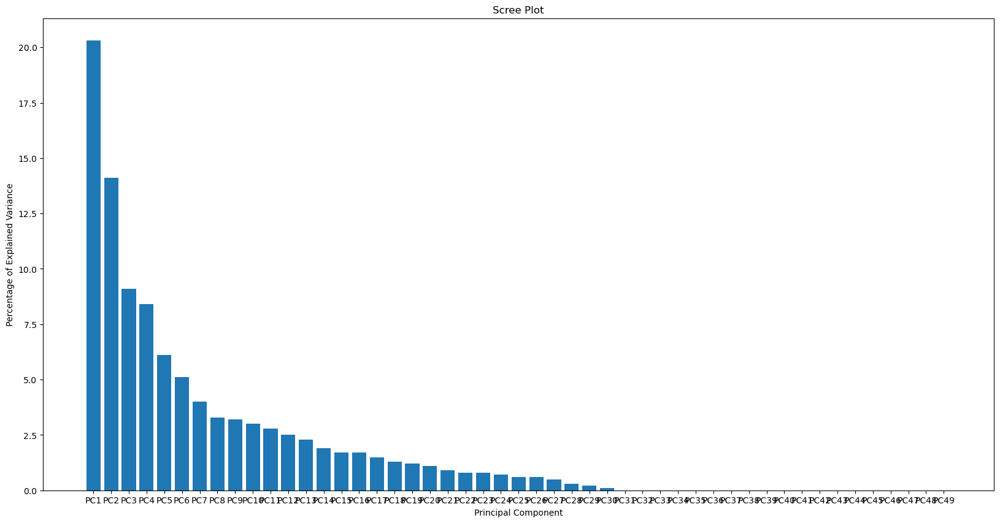

In [7]:
percentage_variance = np.round(pca.explained_variance_ratio_* 100, decimals=1)
labels = ['PC' + str(x) for x in range(1, len(percentage_variance)+1)]
 
plt.figure(figsize=(20, 10))
plt.bar(x=range(1,len(percentage_variance)+1), height=percentage_variance, tick_label=labels)
plt.ylabel('Percentage of Explained Variance')
plt.xlabel('Principal Component')
plt.title('Scree Plot')
plt.show()

In [8]:
percentage_variance

array([20.3, 14.1,  9.1,  8.4,  6.1,  5.1,  4. ,  3.3,  3.2,  3. ,  2.8,
        2.5,  2.3,  1.9,  1.7,  1.7,  1.5,  1.3,  1.2,  1.1,  0.9,  0.8,
        0.8,  0.7,  0.6,  0.6,  0.5,  0.3,  0.2,  0.1,  0. ,  0. ,  0. ,
        0. ,  0. ,  0. ,  0. ,  0. ,  0. ,  0. ,  0. ,  0. ,  0. ,  0. ,
        0. ,  0. ,  0. ,  0. ,  0. ])

In [9]:
pca_df = pd.DataFrame(pca_data, columns = labels)
pca_df

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC40,PC41,PC42,PC43,PC44,PC45,PC46,PC47,PC48,PC49
0,-5.922593,0.178522,-0.474652,0.734957,-1.088580,0.538084,1.054360,0.408501,-1.080408,-1.231148,...,-0.000934,-0.000151,-0.000842,0.000108,3.985883e-05,-0.000164,1.149872e-04,-1.320334e-05,0.000004,-6.412891e-06
1,-5.850397,-0.331863,-0.459220,0.726605,-1.536848,-0.002095,1.488871,0.525997,-0.130676,-0.368756,...,0.001002,-0.000167,0.000370,-0.000038,-6.881878e-05,-0.000093,1.188295e-04,-3.322517e-07,0.000001,-3.004407e-06
2,-5.479152,-0.555967,-1.285354,1.183179,-0.714981,0.441316,0.952786,0.747292,0.245611,-0.087698,...,0.000140,-0.000119,0.000284,-0.000115,6.592041e-07,-0.000105,2.760417e-04,5.393634e-06,0.000003,8.560397e-08
3,-5.960447,0.276276,-0.331118,1.156805,0.337033,0.029934,0.821679,0.272014,0.231090,-1.483347,...,-0.003233,0.000291,-0.000375,-0.000051,-6.173631e-05,0.000048,1.580281e-04,3.158312e-05,0.000008,2.089421e-05
4,-5.859873,0.310376,-0.781595,0.875535,1.049994,0.705198,1.052463,1.662415,0.077179,-0.770945,...,0.000235,-0.000827,0.001127,-0.000076,-2.965920e-04,-0.000153,3.230527e-05,3.542028e-05,-0.000047,1.723374e-05
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58504,5.705087,5.066816,-1.055976,-2.963968,2.810677,0.441510,1.690014,-1.067270,0.027020,1.191003,...,-0.001128,0.000253,0.001061,0.001558,7.804694e-04,-0.000879,-4.672636e-07,8.713840e-06,-0.000019,5.560955e-05
58505,6.042462,5.318584,-1.271116,-1.832840,2.861320,1.399733,1.827818,0.073537,1.752933,1.136092,...,-0.003008,0.000432,0.000503,-0.004677,5.494243e-04,0.000258,3.482081e-04,1.052923e-03,0.000009,2.054584e-04
58506,6.561613,4.805284,-1.052990,-2.193502,3.998868,-1.172423,1.349585,1.360812,-0.156428,0.954845,...,-0.000322,-0.000968,-0.007892,-0.002900,5.752507e-04,0.000455,-2.826235e-04,-2.383582e-04,0.000231,-1.096939e-05
58507,5.839806,4.929493,-1.159155,-2.983311,2.906297,-0.285788,1.455484,0.883016,-0.834428,0.851588,...,0.004282,0.001597,-0.000588,-0.001798,7.947871e-04,-0.000097,1.124727e-04,-9.391376e-05,0.000044,5.747080e-05


# PCA for 8 components combinations

In [10]:
import plotly.express as px
plt.figure(figsize = (30,30))

# implementing one dimensional reduction using PCA
pca_data_all = PCA(n_components=8,random_state=0)
pca_data_all.fit(df_scaled)
pca_trans=pca_data_all.transform(df_scaled)
labels = {
    str(i): f"PC {i+1} ({var:.2f}%)"
    for i, var in enumerate(pca_data_all.explained_variance_ratio_ * 100)}

fig = px.scatter_matrix(pca_trans,labels=labels,dimensions=range(8),color=y)
fig.update_traces(diagonal_visible=True)
fig.show()

<Figure size 3000x3000 with 0 Axes>

# Two-component PCA with output clusters

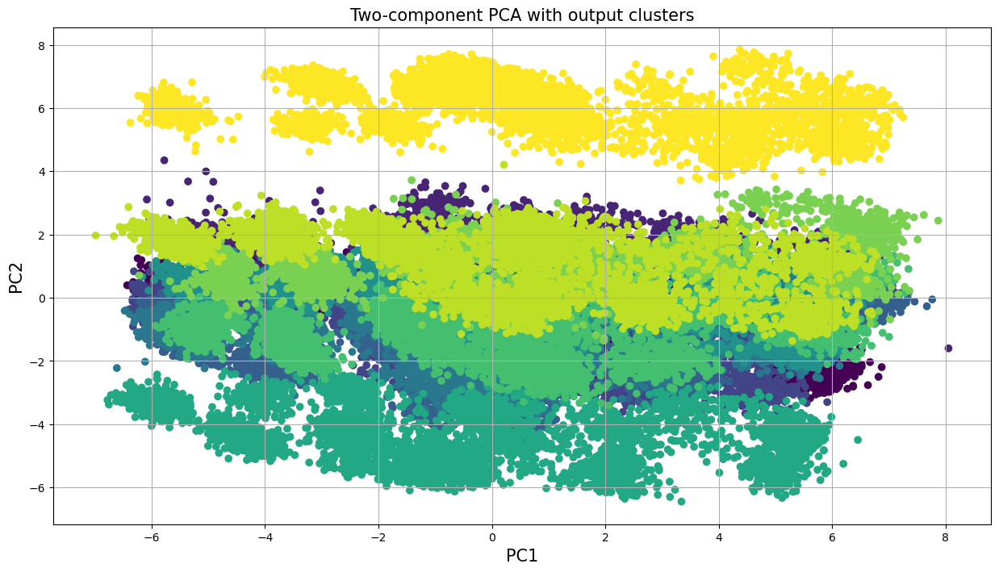

In [11]:
# Taking first 2 components for visualization
plt.figure(figsize=(15,8))

plt.scatter(pca_df.PC1, pca_df.PC2, c = y)
plt.xlabel("PC1", fontsize = 15)
plt.ylabel("PC2", fontsize = 15)
plt.title("Two-component PCA with output clusters", fontsize = 15)
plt.grid();

# Three-component PCA with output clusters

Text(0.5, 0, '$PC 3$')

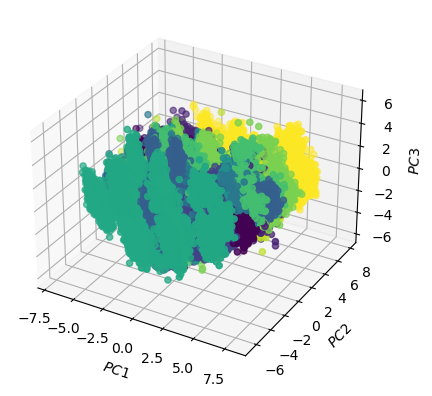

In [12]:
ax = plt.axes(projection='3d')

# X, Y, and Z axes data represent: Principal component 1, Principal component 2, and principal component 3 respectively.
zdata = pca_df['PC3'].to_numpy()
xdata = pca_df['PC1'].to_numpy()
ydata = pca_df['PC2'].to_numpy()

ax.scatter3D(xdata, ydata, zdata, c=y);
ax.set_xlabel('$PC 1$', fontsize=10, rotation=150)
ax.set_ylabel('$PC 2$')
ax.set_zlabel(r'$PC 3$', fontsize=10)

# Two-component PCA with current_1

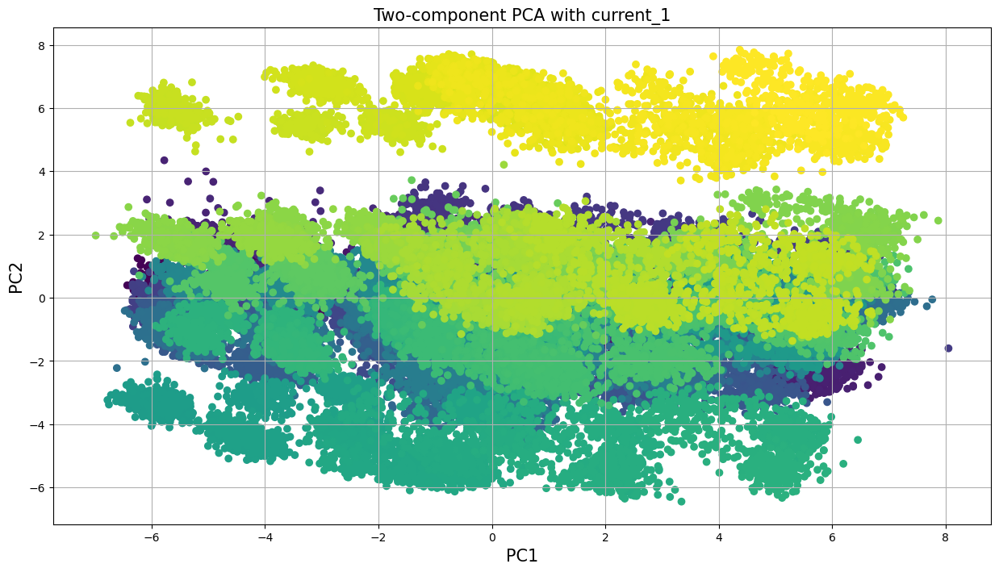

In [13]:
# Taking first 2 components for visualization
plt.figure(figsize=(15,8))

plt.scatter(pca_df.PC1, pca_df.PC2, c = df["current_1"])
plt.xlabel("PC1", fontsize = 15)
plt.ylabel("PC2", fontsize = 15)
plt.title("Two-component PCA with current_1", fontsize = 15)
plt.grid();

# Three-component PCA with current_1

Text(0.5, 0, '$PC 3$')

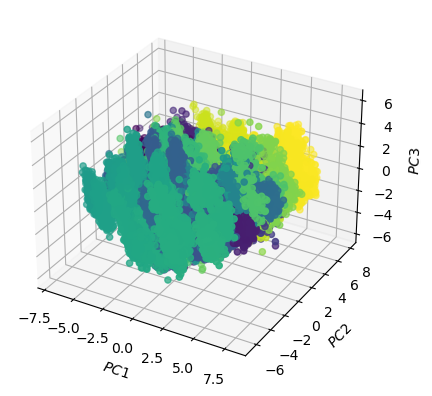

In [14]:
ax = plt.axes(projection='3d')

# X, Y, and Z axes data represent: Principal component 1, Principal component 2, and principal component 3 respectively.
zdata = pca_df['PC3'].to_numpy()
xdata = pca_df['PC1'].to_numpy()
ydata = pca_df['PC2'].to_numpy()

ax.scatter3D(xdata, ydata, zdata, c=df["current_1"]);
ax.set_xlabel('$PC 1$', fontsize=10, rotation=150)
ax.set_ylabel('$PC 2$')
ax.set_zlabel(r'$PC 3$', fontsize=10)

# Two-component with PCA current_20

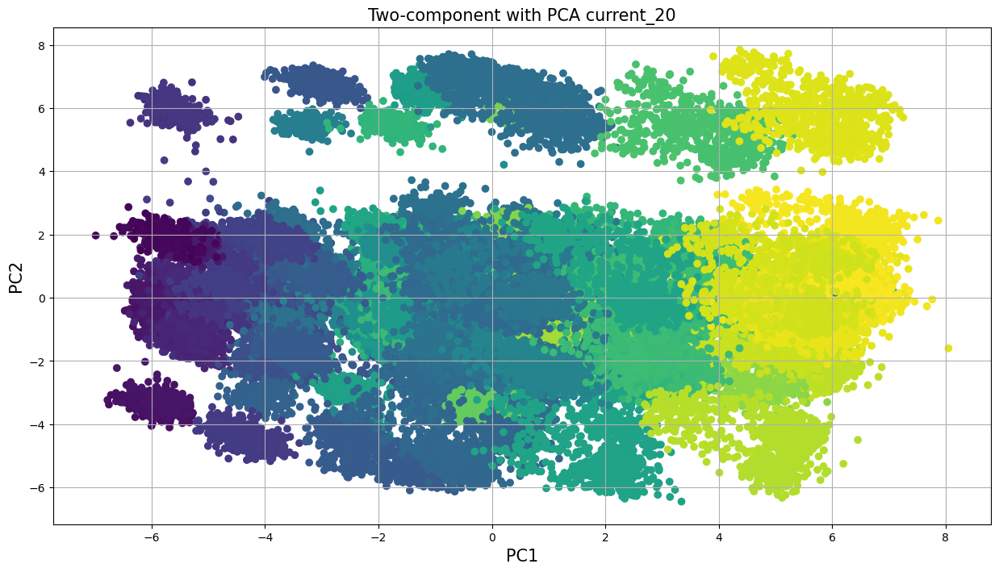

In [15]:
# Taking first 2 components for visualization
plt.figure(figsize=(15,8))

plt.scatter(pca_df.PC1, pca_df.PC2, c = df["current_20"])
plt.xlabel("PC1", fontsize = 15)
plt.ylabel("PC2", fontsize = 15)
plt.title("Two-component with PCA current_20", fontsize = 15)
plt.grid();

# Three-component with PCA current_20

Text(0.5, 0, '$PC 3$')

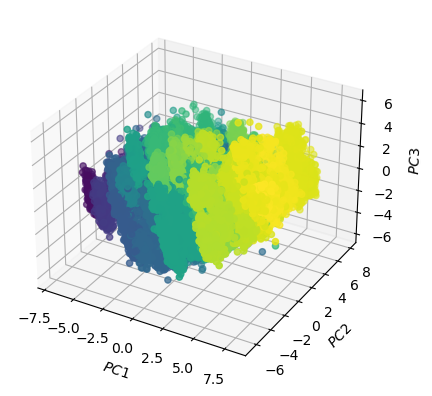

In [16]:
ax = plt.axes(projection='3d')

# X, Y, and Z axes data represent: Principal component 1, Principal component 2, and principal component 3 respectively.
zdata = pca_df['PC3'].to_numpy()
xdata = pca_df['PC1'].to_numpy()
ydata = pca_df['PC2'].to_numpy()

ax.scatter3D(xdata, ydata, zdata, c=df["current_20"]);
ax.set_xlabel('$PC 1$', fontsize=10, rotation=150)
ax.set_ylabel('$PC 2$')
ax.set_zlabel(r'$PC 3$', fontsize=10)

# Non Linear Dimensionality reduction - kernel PCA

In [17]:
kpca= KernelPCA(n_components=None,kernel = 'rbf',gamma = 10)

In [18]:
# Kerenel PCA is not supporting high dimensional data ,so taking first 20000 rows of the data for analysis.
df_kernel = kpca.fit_transform(df_scaled[1:10000])

# For output

In [19]:
new_df = df_scaled[1:10000]
y1=y[1:10000]

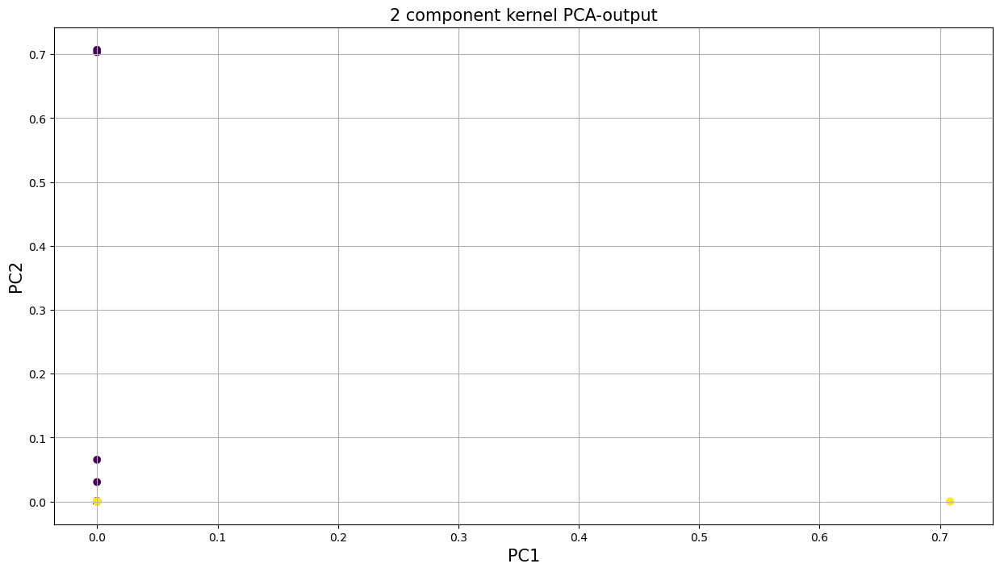

In [20]:
plt.figure(figsize=(15,8))

plt.scatter(df_kernel[:,0], df_kernel[:,1] ,c = y1)
plt.xlabel("PC1", fontsize = 15)
plt.ylabel("PC2", fontsize = 15)
plt.title("2 component kernel PCA-output", fontsize = 15)
plt.grid();

# For current_1

In [21]:
new_df = df_scaled[1:10000]
y2=new_df['current_1']

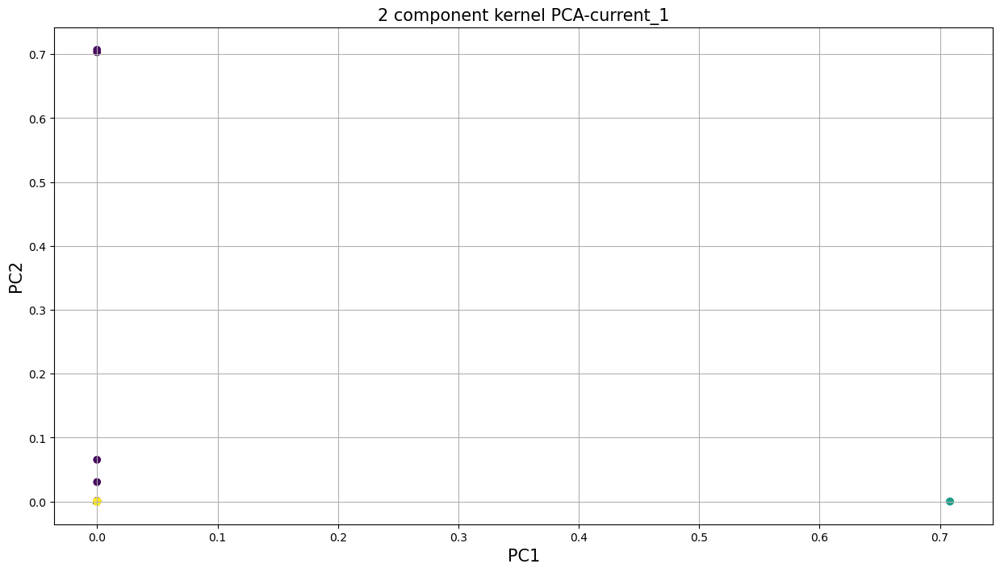

In [22]:
plt.figure(figsize=(15,8))

plt.scatter(df_kernel[:,0], df_kernel[:,1] ,c = y2)
plt.xlabel("PC1", fontsize = 15)
plt.ylabel("PC2", fontsize = 15)
plt.title("2 component kernel PCA-current_1", fontsize = 15)
plt.grid();

In [23]:
new_df = df_scaled[1:10000]
y3=new_df['current_20']

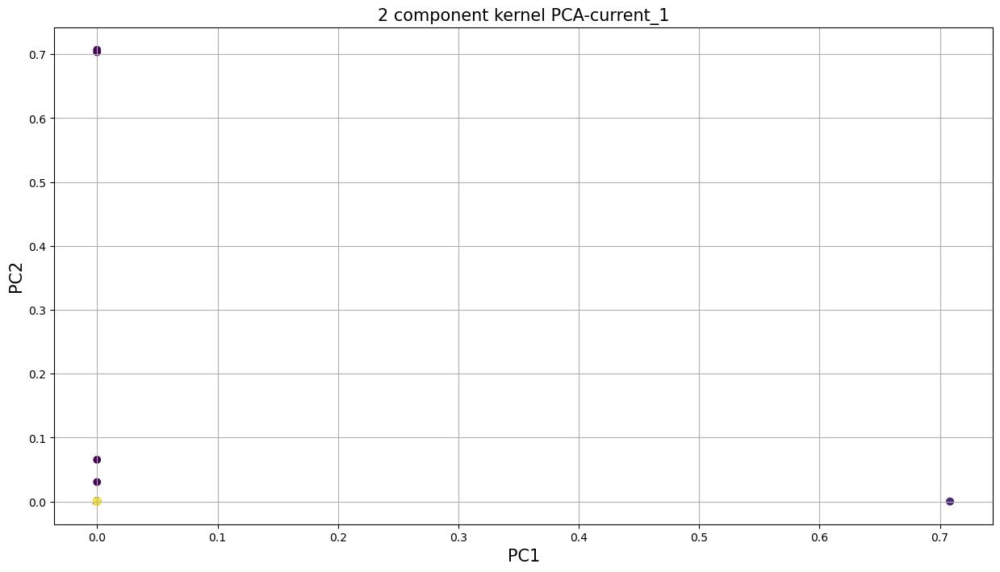

In [24]:
plt.figure(figsize=(15,8))

plt.scatter(df_kernel[:,0], df_kernel[:,1] ,c = y3)
plt.xlabel("PC1", fontsize = 15)
plt.ylabel("PC2", fontsize = 15)
plt.title("2 component kernel PCA-current_1", fontsize = 15)
plt.grid();

# KMEANS clustring After dimensionality reduction

In [55]:
# perform linear dimensionality reduction using PCA
pca = PCA(n_components=2)
pca_data2 = pca.fit_transform(df_scaled)
pca_data2 = pd.DataFrame(pca_data2, columns = ["PC1","PC2"])
pca_data2

,PC1,PC2
0,-5.922593,0.178523
1,-5.850397,-0.331867
2,-5.479152,-0.555968
3,-5.960446,0.276278
4,-5.859873,0.310377
...,...,...
58504,5.705086,5.066816
58505,6.042462,5.318588
58506,6.561613,4.805283
58507,5.839806,4.929495


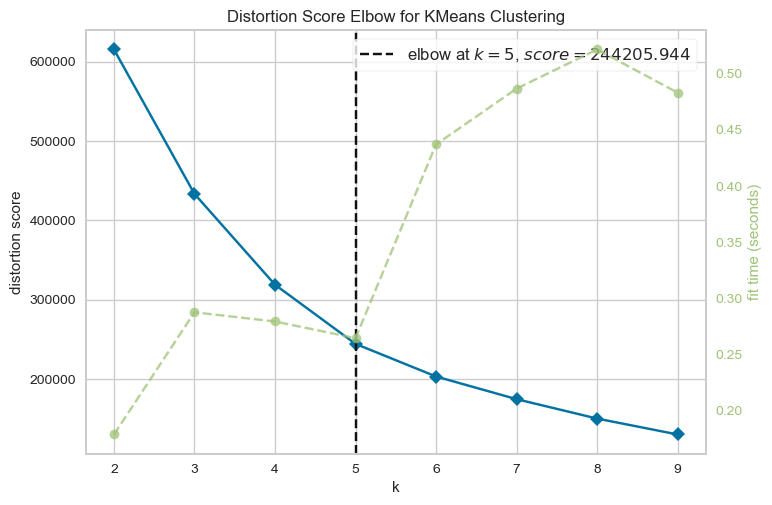

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [56]:
km = KMeans(random_state=42)
visualizer = KElbowVisualizer(km, k=(2,10))
 
visualizer.fit(pca_data2)        # Fit the data to the visualizer
visualizer.show()        # Finalize and render the figure

In [57]:
kmeans = KMeans(n_clusters=5, random_state=42).fit(pca_data2)

In [58]:
y_pred = kmeans.predict(pca_data2)
y_pred

array([2, 2, 2, ..., 4, 4, 3], dtype=int32)

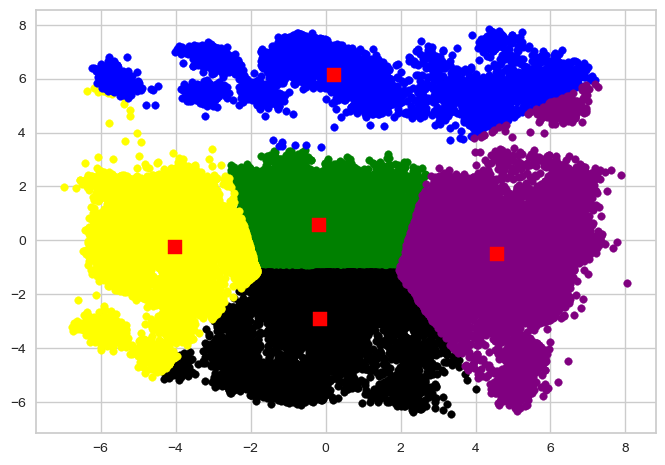

In [59]:
# visualize clustering results using PCA

labels = [0, 1, 2,3,4]
colors = ["green", "black", "yellow","blue","purple"]

for label, color in zip(labels, colors):
    index = y_pred==label
    plt.scatter(pca_data2.loc[index, "PC1"],
                pca_data2.loc[index, "PC2"],
                c = color,
                s=30)
    
plt.scatter(kmeans.cluster_centers_[:,0], kmeans.cluster_centers_[:,1], color="red", marker="s", s=100);